<a href="https://colab.research.google.com/github/littlehousezh/mml2_image_matching/blob/main/MML2_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# EDA


## Import

In [36]:
import tensorflow as tf
import tensorflow_hub as tfhub
import tensorflow_addons as tfa
import pandas as pd; pd.options.mode.chained_assignment = None;
import numpy as np
import sklearn
from sklearn.preprocessing import RobustScaler, PolynomialFeatures
from pandarallel import pandarallel; pandarallel.initialize();
from sklearn.model_selection import GroupKFold, StratifiedKFold
from scipy.spatial import cKDTree

# Built In
#from kaggle_datasets import KaggleDatasets
from collections import Counter
from datetime import datetime
from glob import glob
import warnings
import requests
import hashlib
import imageio
import IPython
import sklearn
import urllib
import zipfile
import pickle
import random
import shutil
import string
import json
import math
import time
import gzip
import ast
import sys
import io
import os
import gc
import re

# Visualization
from matplotlib.colors import ListedColormap
import matplotlib.patches as patches
import plotly.graph_objects as go
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm; tqdm.pandas();
import plotly.express as px
import seaborn as sns
from PIL import Image, ImageEnhance
import matplotlib
from matplotlib import animation, rc; rc('animation', html='jshtml')
import plotly
import PIL
import cv2

import plotly.io as pio
#print(pio.renderers)

def seed_it_all(seed=7):
    """ Attempt to be Reproducible """
    os.environ['PYTHONHASHSEED'] = str(seed)
    random.seed(seed)
    np.random.seed(seed)
    tf.random.set_seed(seed)


INFO: Pandarallel will run on 1 workers.
INFO: Pandarallel will use Memory file system to transfer data between the main process and workers.


In [ ]:
## import kaggle data to colab
from google.colab import drive 

drive.mount('/content/gdrive/') 



!pip install kaggle
from google.colab import files
files.upload()


!mkdir -p ~/.kaggle 

!cp kaggle.json ~/.kaggle/ 

!chmod 600 ~/.kaggle/kaggle.json 


! kaggle competitions download -c image-matching-challenge-2022

! unzip image-matching-challenge-2022.zip -d image-matching-challenge-2022

In [5]:
! kaggle kernels output dschettler8845/Offline-DELF-From-TFHUB
! ls

403 - Forbidden
gdrive			       image-matching-challenge-2022.zip  sample_data
image-matching-challenge-2022  kaggle.json


In [16]:
# Detect hardware, return appropriate distribution strategy
try:
    # TPU detection. No parameters necessary if TPU_NAME environment variable is set. On Kaggle this is always the case.
    TPU = tf.distribute.cluster_resolver.TPUClusterResolver()  
except ValueError:
    TPU = None

if TPU:
    print(f"\n... RUNNING ON TPU - {TPU.master()}...")
    tf.config.experimental_connect_to_cluster(TPU)
    tf.tpu.experimental.initialize_tpu_system(TPU)
    strategy = tf.distribute.experimental.TPUStrategy(TPU)
else:
    print(f"\n... RUNNING ON CPU/GPU ...")
    # Yield the default distribution strategy in Tensorflow
    #   --> Works on CPU and single GPU.
    strategy = tf.distribute.get_strategy() 

N_REPLICAS = strategy.num_replicas_in_sync

# enable XLA optmizations (10% speedup when using @tf.function calls)
tf.config.optimizer.set_jit(True)


... RUNNING ON CPU/GPU ...


In [37]:
# Access data
if TPU:
    # Google Cloud Dataset path to training and validation images
    DATA_DIR = "/content/image-matching-challenge-2022/"
    #DATA_DIR = KaggleDatasets().get_gcs_path('image-matching-challenge-2022')
    save_locally = tf.saved_model.SaveOptions(experimental_io_device='/job:localhost')
    load_locally = tf.saved_model.LoadOptions(experimental_io_device='/job:localhost')
else:
    # Local path to training and validation images
    DATA_DIR = "/content/image-matching-challenge-2022/"
    save_locally = None
    load_locally = None

print(f"DATA DIRECTORY PATH IS: --> {DATA_DIR}")

print(f"IMMEDIATE CONTENTS OF DATA DIRECTORY IS:")
for file in tf.io.gfile.glob(os.path.join(DATA_DIR, "*")): print(f"\t--> {file}")

DATA DIRECTORY PATH IS:--> /content/image-matching-challenge-2022/
IMMEDIATE CONTENTS OF DATA DIRECTORY IS:
	--> /content/image-matching-challenge-2022/train
	--> /content/image-matching-challenge-2022/test.csv
	--> /content/image-matching-challenge-2022/test_images
	--> /content/image-matching-challenge-2022/sample_submission.csv


## Basic data definition & initialization

In [19]:
# Train data
TRAIN_DIR = os.path.join(DATA_DIR, "train")
SCALING_CSV = os.path.join(TRAIN_DIR, "scaling_factors.csv")
scaling_df = pd.read_csv(SCALING_CSV)
scale_map = scaling_df.groupby("scene")["scaling_factor"].first().to_dict()
TRAIN_SCENES = scaling_df.scene.unique().tolist()

train_map = {} 
for _s in tqdm(TRAIN_SCENES, total=len(TRAIN_SCENES)):
    # Initialize    
    train_map[_s] = {}
    
    # Image Stuff
    train_map[_s]["images"] = sorted(tf.io.gfile.glob(os.path.join(TRAIN_DIR, _s, "images", "*.jpg")))
    train_map[_s]["image_ids"] = [_f_path[:-4].rsplit("/", 1)[-1] for _f_path in train_map[_s]["images"]]
    
    # Calibration Stuff (CAL)
    _tmp_cal_df = pd.read_csv(os.path.join(TRAIN_DIR, _s, "calibration.csv"))
    _tmp_cal_df["image_path"] = os.path.join(TRAIN_DIR, _s, "images")+"/"+_tmp_cal_df["image_id"]+".jpg"
    train_map[_s]["cal_df"]=_tmp_cal_df.copy()
        
    # Pair Covisibility Stuff (PCO)
    _tmp_pco_df = pd.read_csv(os.path.join(TRAIN_DIR, _s, "pair_covisibility.csv"))
    _tmp_pco_df["image_id_1"], _tmp_pco_df["image_id_2"] = zip(*_tmp_pco_df.pair.apply(lambda x: x.split("-")))
    _tmp_pco_df["image_path_1"] = os.path.join(TRAIN_DIR, _s, "images")+"/"+_tmp_pco_df["image_id_1"]+".jpg"
    _tmp_pco_df["image_path_2"] = os.path.join(TRAIN_DIR, _s, "images")+"/"+_tmp_pco_df["image_id_2"]+".jpg"
    train_map[_s]["pco_df"] = _tmp_pco_df.copy()

#cleanup
del _tmp_cal_df, _tmp_pco_df; gc.collect(); gc.collect();
    
print("TEST META DATA")
TEST_IMG_DIR = os.path.join(DATA_DIR, "test_images")
TEST_CSV = os.path.join(DATA_DIR, "test.csv")
test_df = pd.read_csv(TEST_CSV)
test_df["f_path_1"] = TEST_IMG_DIR+"/"+test_df.batch_id+"/"+test_df.image_1_id+".png"
test_df["f_path_2"] = TEST_IMG_DIR+"/"+test_df.batch_id+"/"+test_df.image_2_id+".png"
display(test_df)

SS_CSV = os.path.join(DATA_DIR, "sample_submission.csv")
ss_df = pd.read_csv(SS_CSV)
display(ss_df)


... BASIC DATA SETUP STARTING ...



... TRAIN META ...



  0%|          | 0/16 [00:00<?, ?it/s]


... TEST META ...



,sample_id,batch_id,image_1_id,image_2_id,f_path_1,f_path_2
0,googleurban;1cf87530;a5a9975574c94ff9a285f58c3...,1cf87530,a5a9975574c94ff9a285f58c39b53d2c,0143f47ee9e54243a1b8454f3e91621a,/content/image-matching-challenge-2022/test_im...,/content/image-matching-challenge-2022/test_im...
1,googleurban;6ceaefff;39563e58b2b7411da3f06427c...,6ceaefff,39563e58b2b7411da3f06427c9ee4239,0303b05ca0cb46959eac430e4b2472ca,/content/image-matching-challenge-2022/test_im...,/content/image-matching-challenge-2022/test_im...
2,googleurban;d91db836;81dd07fb7b9a4e01996cee637...,d91db836,81dd07fb7b9a4e01996cee637f91ca1a,0006b1337a0347f49b4e651c035dfa0e,/content/image-matching-challenge-2022/test_im...,/content/image-matching-challenge-2022/test_im...


,sample_id,fundamental_matrix
0,googleurban;1cf87530;a5a9975574c94ff9a285f58c3...,0.06377171256744407 0.013457351355713576 0.348...
1,googleurban;6ceaefff;39563e58b2b7411da3f06427c...,0.9482570558218754 0.22187106097992249 0.64012...
2,googleurban;d91db836;81dd07fb7b9a4e01996cee637...,0.11050136659424259 0.7987936275204097 0.06535...


## Some functions

In [20]:
def flatten_l_o_l(nested_list):
    """ Flatten a list of lists """
    nested_list = [x if type(x) is list else [x,] for x in nested_list]
    return [item for sublist in nested_list for item in sublist]

def plot_two_paths(f_path_1, f_path_2, _titles=None):
    plt.figure(figsize=(20, 10))
    
    plt.subplot(1,2,1)
    if _titles is None:
        plt.title(f_path_1, fontweight="bold")
    else:
        plt.title(_titles[0], fontweight="bold")
    plt.imshow(cv2.imread(f_path_1)[..., ::-1])
    plt.axis(False)
    
    plt.subplot(1,2,2)
    if _titles is None:
        plt.title(f_path_2, fontweight="bold")
    else:
        plt.title(_titles[1], fontweight="bold")

    plt.imshow(cv2.imread(f_path_2)[..., ::-1])
    plt.axis(False)
    
    plt.tight_layout()
    plt.show()
    
def pco_random_plot(_df):
    df_row = _df.sample(1).reset_index(drop=True)
    plot_two_paths(
        df_row.image_path_1[0],
        df_row.image_path_2[0],
        [f"Image ID: {df_row.image_id_1} - COV={df_row.covisibility[0]}",
         f"Image ID: {df_row.image_id_2} - COV={df_row.covisibility[0]}",]
    )
    
def arr_from_str(_s):
    return np.fromstring(_s, sep=" ").reshape((-1,3)).squeeze()

def get_id2cal_map(_train_map):
    _id2cal_map = {}
    for _s in tqdm(TRAIN_SCENES, total=len(TRAIN_SCENES)):
        for _, _row in _train_map[_s]["cal_df"].iterrows():
            _img_id = _row["image_id"]; _id2cal_map[_img_id]={}
            _id2cal_map[_img_id]["camera_intrinsics"] = arr_from_str(_row["camera_intrinsics"])
            _id2cal_map[_img_id]["rotation_matrix"] = arr_from_str(_row["rotation_matrix"])
            _id2cal_map[_img_id]["translation_vector"] = arr_from_str(_row["translation_vector"])
            _id2cal_map[_img_id]["image_path"] = _row["image_path"]
    return _id2cal_map

id2cal_map = get_id2cal_map(train_map)

  0%|          | 0/16 [00:00<?, ?it/s]

In [21]:
#  functions for feature identification, matrix manipulations, ...
def extract_sift_features(rgb_image, detector, n_features):
    """ 
    Helper Function to Compute SIFT features for a Given Image
    REFERENCE --> https://www.kaggle.com/code/eduardtrulls/imc2022-training-data?scriptVersionId=92062607
    """
    # Convert RGB image to Grayscale
    gray = cv2.cvtColor(rgb_image, cv2.COLOR_RGB2GRAY)
    
    # Run detector and retrieve only the top keypoints and descriptors 
    kp, desc = detector.detectAndCompute(gray, None)
    
    return kp[:n_features], desc[:n_features]

def extract_keypoints(rgb_image, detector):
    """ 
    Helper Function to Compute SIFT features for a Given Image
    REFERENCE --> https://www.kaggle.com/code/eduardtrulls/imc2022-training-data?scriptVersionId=92062607
    """
    # Convert RGB image to Grayscale
    gray = cv2.cvtColor(rgb_image, cv2.COLOR_RGB2GRAY)
    
    # Run detector and retrieve the keypoints
    return detector.detect(gray)

def build_composite_image(im1, im2, axis=1, margin=0, background=1):
    """
    Convenience function to stack two images with different sizes.
    REFERENCE --> https://www.kaggle.com/code/eduardtrulls/imc2022-training-data?scriptVersionId=92062607
    """
    
    if background != 0 and background != 1:
        background = 1
    if axis != 0 and axis != 1:
        raise RuntimeError('Axis must be 0 (vertical) or 1 (horizontal')

    h1, w1, _ = im1.shape
    h2, w2, _ = im2.shape

    if axis == 1:
        composite = np.zeros((max(h1, h2), w1 + w2 + margin, 3), dtype=np.uint8) + 255 * background
        if h1 > h2:
            voff1, voff2 = 0, (h1 - h2) // 2
        else:
            voff1, voff2 = (h2 - h1) // 2, 0
        hoff1, hoff2 = 0, w1 + margin
    else:
        composite = np.zeros((h1 + h2 + margin, max(w1, w2), 3), dtype=np.uint8) + 255 * background
        if w1 > w2:
            hoff1, hoff2 = 0, (w1 - w2) // 2
        else:
            hoff1, hoff2 = (w2 - w1) // 2, 0
        voff1, voff2 = 0, h1 + margin
    composite[voff1:voff1 + h1, hoff1:hoff1 + w1, :] = im1
    composite[voff2:voff2 + h2, hoff2:hoff2 + w2, :] = im2

    return (composite, (voff1, voff2), (hoff1, hoff2))


def draw_cv_matches(im1, im2, kp1, kp2, matches, axis=1, margin=0, background=0, linewidth=2):
    """
    Draw keypoints and matches.
    REFERENCE --> https://www.kaggle.com/code/eduardtrulls/imc2022-training-data?scriptVersionId=92062607
    """
    
    composite, v_offset, h_offset = build_composite_image(im1, im2, axis, margin, background)

    # Draw all keypoints.
    for coord_a, coord_b in zip(kp1, kp2):
        composite = cv2.drawMarker(composite, (int(coord_a[0] + h_offset[0]), int(coord_a[1] + v_offset[0])), color=(255, 0, 0), markerType=cv2.MARKER_CROSS, markerSize=5, thickness=1)
        composite = cv2.drawMarker(composite, (int(coord_b[0] + h_offset[1]), int(coord_b[1] + v_offset[1])), color=(255, 0, 0), markerType=cv2.MARKER_CROSS, markerSize=5, thickness=1)
    
    # Draw matches, and highlight keypoints used in matches.
    for idx_a, idx_b in matches:
        composite = cv2.drawMarker(composite, (int(kp1[idx_a, 0] + h_offset[0]), int(kp1[idx_a, 1] + v_offset[0])), color=(0, 0, 255), markerType=cv2.MARKER_CROSS, markerSize=12, thickness=1)
        composite = cv2.drawMarker(composite, (int(kp2[idx_b, 0] + h_offset[1]), int(kp2[idx_b, 1] + v_offset[1])), color=(0, 0, 255), markerType=cv2.MARKER_CROSS, markerSize=12, thickness=1)
        composite = cv2.line(composite,
                             tuple([int(kp1[idx_a][0] + h_offset[0]),
                                   int(kp1[idx_a][1] + v_offset[0])]),
                             tuple([int(kp2[idx_b][0] + h_offset[1]),
                                   int(kp2[idx_b][1] + v_offset[1])]), color=(0, 0, 255), thickness=1)
    return composite

def normalize_keypoints(keypoints, K):
    C_x = K[0, 2]
    C_y = K[1, 2]
    f_x = K[0, 0]
    f_y = K[1, 1]
    keypoints = (keypoints - np.array([[C_x, C_y]])) / np.array([[f_x, f_y]])
    return keypoints

def compute_essential_matrix(F, K1, K2, kp1, kp2):
    """
    Compute the Essential matrix from the Fundamental matrix, given the calibration matrices. 
    Note that we ask participants to estimate F, i.e., without relying on known intrinsics.
    REFERENCE --> https://www.kaggle.com/code/eduardtrulls/imc2022-training-data?scriptVersionId=92062607
    """
    
    # Warning! Old versions of OpenCV's RANSAC could return multiple F matrices, encoded as a single matrix size 6x3 or 9x3, rather than 3x3.
    # We do not account for this here, as the modern RANSACs do not do this:
    # https://opencv.org/evaluating-opencvs-new-ransacs
    assert F.shape[0] == 3, 'Malformed F?'

    # Use OpenCV's recoverPose to solve the cheirality check:
    # https://docs.opencv.org/4.5.4/d9/d0c/group__calib3d.html#gadb7d2dfcc184c1d2f496d8639f4371c0
    E = np.matmul(np.matmul(K2.T, F), K1).astype(np.float64)
    
    kp1n = normalize_keypoints(kp1, K1)
    kp2n = normalize_keypoints(kp2, K2)
    num_inliers, R, T, mask = cv2.recoverPose(E, kp1n, kp2n)

    return E, R, T

def quaternion_from_matrix(matrix):
    """
    Transform a rotation matrix into a quaternion
    REFERENCE --> https://www.kaggle.com/code/eduardtrulls/imc2022-training-data?scriptVersionId=92062607
    
    The quaternion is the eigenvector of K that corresponds to the largest eigenvalue.\
    """

    M = np.array(matrix, dtype=np.float64, copy=False)[:4, :4]
    m00 = M[0, 0]
    m01 = M[0, 1]
    m02 = M[0, 2]
    m10 = M[1, 0]
    m11 = M[1, 1]
    m12 = M[1, 2]
    m20 = M[2, 0]
    m21 = M[2, 1]
    m22 = M[2, 2]

    K = np.array([
        [m00 - m11 - m22, 0.0, 0.0, 0.0],
        [m01 + m10, m11 - m00 - m22, 0.0, 0.0],
        [m02 + m20, m12 + m21, m22 - m00 - m11, 0.0],
        [m21 - m12, m02 - m20, m10 - m01, m00 + m11 + m22]
    ])
    K /= 3.0

    # The quaternion is the eigenvector of K that corresponds to the largest eigenvalue.
    w, V = np.linalg.eigh(K)
    q = V[[3, 0, 1, 2], np.argmax(w)]
    if q[0] < 0:
        np.negative(q, q)
    return q


def compute_error_for_example(q_gt, T_gt, q, T, scale, eps=1e-15):
    '''Compute the error metric for a single example.
    
    The function returns two errors, over rotation and translation. 
    These are combined at different thresholds by ComputeMaa in order to compute the mean Average Accuracy.'''
    
    q_gt_norm = q_gt / (np.linalg.norm(q_gt) + eps)
    q_norm = q / (np.linalg.norm(q) + eps)

    loss_q = np.maximum(eps, (1.0 - np.sum(q_norm * q_gt_norm)**2))
    err_q = np.arccos(1 - 2 * loss_q)

    # Apply the scaling factor for this scene.
    T_gt_scaled = T_gt * scale
    T_scaled = T * np.linalg.norm(T_gt) * scale / (np.linalg.norm(T) + eps)

    err_t = min(np.linalg.norm(T_gt_scaled - T_scaled), np.linalg.norm(T_gt_scaled + T_scaled))

    return err_q * 180 / np.pi, err_t

## EDA

### 1. Trainning data
Before we can make some simple deductions, we need to combine the data as much as possible so we can view it with a comprehensive lense.

In [22]:
_cal_dfs = []
_pco_dfs = []
_s_dfs = []
for _s in TRAIN_SCENES:
    _s_map = train_map[_s]
    _s_dfs.append(pd.DataFrame({
        "scene":[_s,]*len(_s_map["images"]),
        "f_path":_s_map["images"],
    }))
    _cal_dfs.append(_s_map["cal_df"])
    _pco_dfs.append(_s_map["pco_df"])

all_pco_dfs = pd.concat(_pco_dfs).reset_index(drop=True)
all_cal_dfs = pd.concat(_cal_dfs).reset_index(drop=True)

train_df = pd.concat(_s_dfs).reset_index(drop=True)
train_df.insert(0, "image_id", train_df.f_path.apply(lambda x: x[:-4].rsplit("/", 1)[-1]))
train_df = pd.merge(train_df, all_cal_dfs, on="image_id").drop(columns=["image_path",])

cov_1_df = all_pco_dfs[["image_id_1", "covisibility"]]
cov_1_df.columns = ["image_id", "covisibility"]
cov_2_df = all_pco_dfs[["image_id_2", "covisibility"]]
cov_2_df.columns = ["image_id", "covisibility"]
cov_df = pd.concat([cov_1_df,cov_2_df])
img_id_2_cov = cov_df.groupby("image_id")["covisibility"].mean().to_dict()
del cov_1_df, cov_2_df, cov_df; gc.collect();

# Add a column for average covisibility
#    - i.e. For a given image, what is the average 
#           covisibility of all of it's respective pairs
train_df.insert(2, "mean_covisibility", train_df.image_id.map(img_id_2_cov))
train_df

,image_id,scene,mean_covisibility,f_path,camera_intrinsics,rotation_matrix,translation_vector
0,00742386_5921667484,british_museum,0.243446,/content/image-matching-challenge-2022/train/b...,4.72572266e+02 0.00000000e+00 5.20500000e+02 0...,9.74603961e-01 -2.19104507e-02 -2.22861059e-01...,3.35075635e+00 -4.17728572e-01 -4.15340570e+00
1,01858319_78150445,british_museum,0.234651,/content/image-matching-challenge-2022/train/b...,1.06637769e+03 0.00000000e+00 5.31500000e+02 0...,9.99352640e-01 -2.33136133e-02 2.74003163e-02 ...,-1.21699487e+00 -4.01113542e+00 -5.39211925e+00
2,02724900_7322693146,british_museum,0.463274,/content/image-matching-challenge-2022/train/b...,8.25332214e+02 0.00000000e+00 5.14000000e+02 0...,9.86743499e-01 -5.35419978e-02 1.53200922e-01 ...,-3.67522997e+00 -9.12454938e-01 -3.44140669e+00
3,03077758_153556086,british_museum,0.429823,/content/image-matching-challenge-2022/train/b...,1.15308435e+03 0.00000000e+00 5.26000000e+02 0...,9.94158829e-01 -3.77749958e-02 1.01100312e-01 ...,-2.72260873e+00 4.63452881e-01 3.58516093e+00
4,03576546_367645446,british_museum,0.461463,/content/image-matching-challenge-2022/train/b...,1.00446088e+03 0.00000000e+00 5.31500000e+02 0...,9.87825273e-01 -1.99821212e-02 1.54278792e-01 ...,-3.00113671e+00 -2.72278489e-01 -9.73755283e-01
...,...,...,...,...,...,...,...
5673,99678699_7739302088,trevi_fountain,0.403955,/content/image-matching-challenge-2022/train/t...,7.86585632e+02 0.00000000e+00 3.37000000e+02 0...,9.89822655e-01 -4.94322996e-02 -1.33444964e-01...,1.28557482e+00 -7.80665079e-01 -1.06299869e+00
5674,99698300_4803158707,trevi_fountain,0.248038,/content/image-matching-challenge-2022/train/t...,1.37912988e+03 0.00000000e+00 5.78500000e+02 0...,9.99986830e-01 2.58788190e-03 -4.43204644e-03 ...,7.54850378e-02 3.20392384e-01 1.59970622e+01
5675,99804374_8024711160,trevi_fountain,0.407271,/content/image-matching-challenge-2022/train/t...,1.13693420e+03 0.00000000e+00 5.30500000e+02 0...,9.61603843e-01 5.06397318e-02 2.69728877e-01 -...,-3.01360231e+00 1.51179662e+00 3.37595039e+00
5676,99943079_8235164998,trevi_fountain,0.465011,/content/image-matching-challenge-2022/train/t...,8.58017151e+02 0.00000000e+00 5.31000000e+02 0...,9.28144175e-01 -8.82999678e-02 -3.61595778e-01...,1.53525034e+00 -7.13913386e-01 -9.35747491e-01


In [23]:
fig = px.histogram(train_df, "scene", color="scene", title="<b>Image Counts By Scene</b>")
fig.update_layout(
    yaxis_title="<b>Number Of Images</b>", xaxis_title="<b>Scene Identifier</b>",
    legend_title="<b>Scene Identifier</b>", showlegend=False,
)
fig.show()

fig = px.histogram(train_df, "mean_covisibility", color="scene", title="<b>Average Covisibility Of Images Coloured By Scene</b>", )
fig.update_layout(
    yaxis_title="<b>Number Of Images Per Covisibility Bin</b>", xaxis_title="<b>Covisibility (0-1.00)</b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()

### 2. Camera matrix 
investigate the distribution of the respective values within the provided train dataset. 
- extract the respective information entities from the intrinsics matrix, 
- verify certain assumptions, 
- plot the relevant distributions.

In [24]:
# Our intrinsics matrix is a flat string[idx], but when reshaped to 3x3 it will map as follows...
# STRING --> "TL[0] T[1] TR[2] CL[3] C[4] CR[5] BL[6] B[7] BR[8]"
#
# MATRIX BELOW
##############
#            #
#  TL  T  TR #
#  CL  C  CR #
#  BL  B  BR #
#            #
##############
# 
# Therefore we just index into the string and convert to a digit to access certain elements
train_df["fx"] = train_df.camera_intrinsics.apply(lambda x: float(x.split()[0])) # 0 = TL 
train_df["fy"] = train_df.camera_intrinsics.apply(lambda x: float(x.split()[4])) # 4 = C
train_df["x0"] = train_df.camera_intrinsics.apply(lambda x: float(x.split()[2])) # 0 = TR
train_df["y0"] = train_df.camera_intrinsics.apply(lambda x: float(x.split()[5])) # 4 = CR
train_df["s"] = train_df.camera_intrinsics.apply(lambda x: float(x.split()[1])) # 1 = TC

if (train_df["fx"]!=train_df["fy"]).sum()==0:
    print("All fx values (focal length x) are equal to the respective fy values (focal length y)... as expected")
    
if train_df["s"].sum()==0:
    print("All skew values are 0... as expected")

All fx values (focal length x) are equal to the respective fy values (focal length y)... as expected
All skew values are 0... as expected


In [25]:
fig = px.histogram(train_df, "x0", title="<b>Principal Point Offset [x<sub>0</sub>] Coloured By Scene</b>", color="scene", log_y=False)
fig.update_layout(
    yaxis_title="<b>Number Of Images Per x<sub>0</sub> Bin</b>", xaxis_title="<b>Principal Point Offset [x<sub>0</sub>]</b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()

fig = px.histogram(train_df, "y0", title="<b>Principal Point Offset [y<sub>0</sub>] Coloured By Scene</b>", color="scene", log_y=False)
fig.update_layout(
    yaxis_title="<b>Number Of Images Per y<sub>0</sub> Bin</b>", xaxis_title="<b>Principal Point Offset [y<sub>0</sub>]</b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()

# We use "fx" because all "fx" values are equivalent to "fy" values
fig = px.histogram(train_df, "fx", title="<b>Focal Lengths Coloured By Scene</b>", color="scene", log_x=True)
fig.update_layout(
    yaxis_title="<b>Number Of Images Per Focal Length Bin</b>", xaxis_title="<b>Focal Length <i>(log scale)</i></b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()

### 3. Camera extrainsics

The camera's extrinsic matrix describes the camera's location in the world (3D), and what direction it's pointing (orientation). It has two components: 
* a rotation matrix, $\mathbf{R}$ (or $\theta$)
* a translation vector $\mathbf{t}$

The extrinsic matrix takes the form of a rigid transformation matrix: 
- a $3\times 3$ rotation matrix in the left-block
- a $3\times 1$ translation column-vector in the right

Let's briefly look into each matrix type to get a grasp of what is happening in each in laymens terms**

In 3D space, rotation can occur about the x, y, or z-axis. Such a type of rotation that occurs about any one of the axis is known as a basic or elementary rotation. Given below are the rotation matrices that can rotate a vector through an angle about any particular axis.


In [26]:
train_df["t_x"] = train_df.translation_vector.apply(lambda x: float(x.split()[0]))
train_df["t_y"] = train_df.translation_vector.apply(lambda x: float(x.split()[1]))
train_df["t_z"] = train_df.translation_vector.apply(lambda x: float(x.split()[2]))

train_df["r1_1"] = train_df.rotation_matrix.apply(lambda x: float(x.split()[0]))
train_df["r2_1"] = train_df.rotation_matrix.apply(lambda x: float(x.split()[1]))
train_df["r3_1"] = train_df.rotation_matrix.apply(lambda x: float(x.split()[2]))
train_df["r1_2"] = train_df.rotation_matrix.apply(lambda x: float(x.split()[3]))
train_df["r2_2"] = train_df.rotation_matrix.apply(lambda x: float(x.split()[4]))
train_df["r3_2"] = train_df.rotation_matrix.apply(lambda x: float(x.split()[5]))
train_df["r1_3"] = train_df.rotation_matrix.apply(lambda x: float(x.split()[6]))
train_df["r2_3"] = train_df.rotation_matrix.apply(lambda x: float(x.split()[7]))
train_df["r3_3"] = train_df.rotation_matrix.apply(lambda x: float(x.split()[8]))

fig = px.histogram(train_df, "t_x", title="<b>Translation Value <sub>x</sub> Coloured By Scene</b>", color="scene", log_y=True)
fig.update_layout(
    yaxis_title="<b>Number Of Images Per Bin <sub>(log-scale)</sub></b>", xaxis_title="<b>Translation Value <sub>x</sub></b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()

fig = px.histogram(train_df, "t_y", title="<b>Translation Value <sub>y</sub> Coloured By Scene</b>", color="scene", log_y=True)
fig.update_layout(
    yaxis_title="<b>Number Of Images Per Bin <sub>(log-scale)</sub></b>", xaxis_title="<b>Translation Value <sub>y</sub></b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()

fig = px.histogram(train_df, "t_z", title="<b>Translation Value <sub>z</sub> Coloured By Scene</b>", color="scene", log_y=True)
fig.update_layout(
    yaxis_title="<b>Number Of Images Per Bin <sub>(log-scale)</sub></b>", xaxis_title="<b>Translation Value <sub>z</sub></b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()


fig = px.histogram(train_df, "r1_1", title="<b>Rotation Value <sub>1,1</sub> Coloured By Scene</b>", color="scene", log_y=True)
fig.update_layout(
    yaxis_title="<b>Number Of Images Per Bin <sub>(log-scale)</sub></b>", xaxis_title="<b>Rotation Value <sub>1,1</sub></b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()


fig = px.histogram(train_df, "r2_1", title="<b>Rotation Value <sub>2,1</sub> Coloured By Scene</b>", color="scene", log_y=True)
fig.update_layout(
    yaxis_title="<b>Number Of Images Per Bin <sub>(log-scale)</sub></b>", xaxis_title="<b>Rotation Value <sub>2,1</sub></b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()


fig = px.histogram(train_df, "r3_1", title="<b>Rotation Value <sub>3,1</sub> Coloured By Scene</b>", color="scene", log_y=True)
fig.update_layout(
    yaxis_title="<b>Number Of Images Per Bin <sub>(log-scale)</sub></b>", xaxis_title="<b>Rotation Value <sub>3,1</sub></b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()


fig = px.histogram(train_df, "r1_2", title="<b>Rotation Value <sub>1,2</sub> Coloured By Scene</b>", color="scene", log_y=True)
fig.update_layout(
    yaxis_title="<b>Number Of Images Per Bin <sub>(log-scale)</sub></b>", xaxis_title="<b>Rotation Value <sub>1,2</sub></b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()


fig = px.histogram(train_df, "r2_2", title="<b>Rotation Value <sub>2,2</sub> Coloured By Scene</b>", color="scene", log_y=True)
fig.update_layout(
    yaxis_title="<b>Number Of Images Per Bin <sub>(log-scale)</sub></b>", xaxis_title="<b>Rotation Value <sub>2,2</sub></b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()


fig = px.histogram(train_df, "r3_2", title="<b>Rotation Value <sub>3,2</sub> Coloured By Scene</b>", color="scene", log_y=True)
fig.update_layout(
    yaxis_title="<b>Number Of Images Per Bin <sub>(log-scale)</sub></b>", xaxis_title="<b>Rotation Value <sub>3,2</sub></b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()


fig = px.histogram(train_df, "r1_3", title="<b>Rotation Value <sub>1,3</sub> Coloured By Scene</b>", color="scene", log_y=True)
fig.update_layout(
    yaxis_title="<b>Number Of Images Per Bin <sub>(log-scale)</sub></b>", xaxis_title="<b>Rotation Value <sub>1,3</sub></b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()


fig = px.histogram(train_df, "r2_3", title="<b>Rotation Value <sub>2,3</sub> Coloured By Scene</b>", color="scene", log_y=True)
fig.update_layout(
    yaxis_title="<b>Number Of Images Per Bin <sub>(log-scale)</sub></b>", xaxis_title="<b>Rotation Value <sub>2,3</sub></b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()

fig = px.histogram(train_df, "r3_3", title="<b>Rotation Value <sub>3,3</sub> Coloured By Scene</b>", color="scene", log_y=True)
fig.update_layout(
    yaxis_title="<b>Number Of Images Per Bin <sub>(log-scale)</sub></b>", xaxis_title="<b>Rotation Value <sub>3,3</sub></b>",
    legend_title="<b>Scene Identifier</b>",
)
fig.show()

### 4. A Example with covisibility and calibration information


EXAMPLE OF HIGH COVISIBILITY


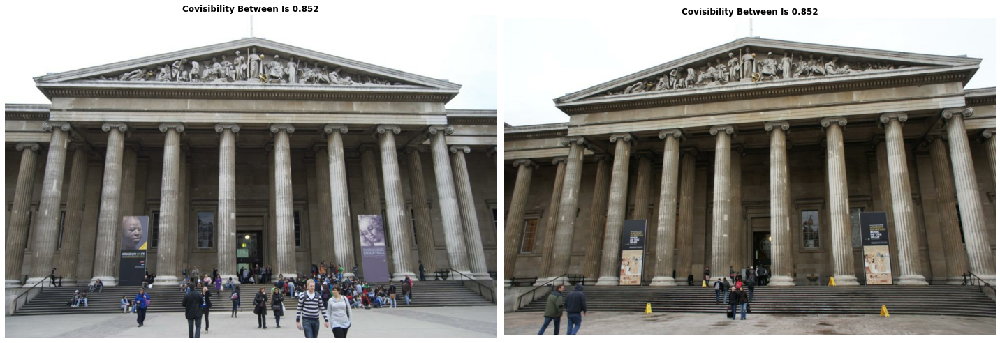




IF WE EXAMINE THE CALIBRATION DATAFRAME ROW FOR THE TOP LEFT IMAGE (ID='93658023_4980549800') WE SEE THE FOLLOWING:


>>>>> CAMERA INTRINSICS ARRAY <<<<<

[[804.200256   0.       528.      ]
 [  0.       804.200256 347.      ]
 [  0.         0.         1.      ]]


>>>>> ROTATION MATRIX ARRAY <<<<<

[[ 0.9964358  -0.00121565 -0.08434587]
 [ 0.02057968  0.97318632  0.22909574]
 [ 0.08180575 -0.23001501  0.96974271]]


>>>>> TRANSLATION VECTOR ARRAY <<<<<

[ 0.79274188 -1.45928287 -5.27820888]



IF WE EXAMINE THE CALIBRATION DATAFRAME ROW FOR THE TOP RIGHT IMAGE (ID='77723525_5227836172') WE SEE THE FOLLOWING:


>>>>> CAMERA INTRINSICS ARRAY <<<<<

[[797.940125   0.       537.5     ]
 [  0.       797.940125 347.5     ]
 [  0.         0.         1.      ]]


>>>>> ROTATION MATRIX ARRAY <<<<<

[[ 0.98950101 -0.00417191  0.14446576]
 [-0.03052383  0.97100314  0.23711011]
 [-0.14126591 -0.23903034  0.96068124]]


>>>>> TRANSLATION VECTOR ARRAY <<<<<

[-3.48984326 -1.54639465 -5.39313744]

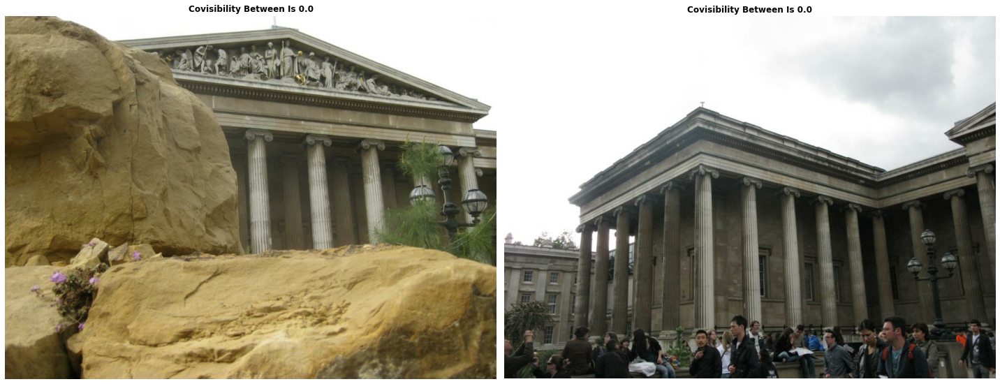




IF WE EXAMINE THE CALIBRATION DATAFRAME ROW FOR THE TOP LEFT IMAGE (ID='66757775_3535589713') WE SEE THE FOLLOWING:


>>>>> CAMERA INTRINSICS ARRAY <<<<<

[[1.12725891e+03 0.00000000e+00 5.27000000e+02]
 [0.00000000e+00 1.12725891e+03 3.89500000e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


>>>>> ROTATION MATRIX ARRAY <<<<<

[[ 0.9300562   0.01826103 -0.36696321]
 [ 0.05503037  0.98057463  0.18826857]
 [ 0.36327279 -0.19529447  0.9109846 ]]


>>>>> TRANSLATION VECTOR ARRAY <<<<<

[ 6.99816401 -0.79084491 -1.80079909]



IF WE EXAMINE THE CALIBRATION DATAFRAME ROW FOR THE TOP RIGHT IMAGE (ID='66747696_4734591579') WE SEE THE FOLLOWING:


>>>>> CAMERA INTRINSICS ARRAY <<<<<

[[1.04641479e+03 0.00000000e+00 5.30000000e+02]
 [0.00000000e+00 1.04641479e+03 3.90500000e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


>>>>> ROTATION MATRIX ARRAY <<<<<

[[ 0.67166298  0.0620151   0.73825671]
 [-0.22051029  0.9680613   0.11930021]
 [-0.70727933 -0.24292273  0.66388591]]


>>>

In [27]:
print("\nEXAMPLE OF HIGH COVISIBILITY")
plot_two_paths(
    train_map["british_museum"]["pco_df"]["image_path_1"][0], 
    train_map["british_museum"]["pco_df"]["image_path_2"][0],
    [f"Covisibility Between Is {train_map['british_museum']['pco_df'].covisibility[0]}",
     f"Covisibility Between Is {train_map['british_museum']['pco_df'].covisibility[0]}"]
)

print("\n\n\nIF WE EXAMINE THE CALIBRATION DATAFRAME ROW FOR THE TOP LEFT IMAGE (ID='93658023_4980549800') WE SEE THE FOLLOWING:")
cal_row_from_id = train_map["british_museum"]["cal_df"][train_map["british_museum"]["cal_df"].image_id=="93658023_4980549800"]
for _property in ["camera_intrinsics", "rotation_matrix", "translation_vector"]:
    print(f"\n\n>>>>> {_property.replace('_', ' ').upper()} ARRAY <<<<<\n")
    print(arr_from_str(cal_row_from_id[_property].values[0]))

print("\n\n\nIF WE EXAMINE THE CALIBRATION DATAFRAME ROW FOR THE TOP RIGHT IMAGE (ID='77723525_5227836172') WE SEE THE FOLLOWING:")
cal_row_from_id = train_map["british_museum"]["cal_df"][train_map["british_museum"]["cal_df"].image_id=="77723525_5227836172"]
for _property in ["camera_intrinsics", "rotation_matrix", "translation_vector"]:
    print(f"\n\n>>>>> {_property.replace('_', ' ').upper()} ARRAY <<<<<\n")
    print(arr_from_str(cal_row_from_id[_property].values[0]))

    
print("\n\n\n\nEXAMPLE OF NO COVISIBILITY")
plot_two_paths(
    train_map["british_museum"]["pco_df"]["image_path_1"][15395],
    train_map["british_museum"]["pco_df"]["image_path_2"][15395],
    [f"Covisibility Between Is {train_map['british_museum']['pco_df'].covisibility[15395]}",
     f"Covisibility Between Is {train_map['british_museum']['pco_df'].covisibility[15395]}"]
)

print("\n\n\nIF WE EXAMINE THE CALIBRATION DATAFRAME ROW FOR THE TOP LEFT IMAGE (ID='66757775_3535589713') WE SEE THE FOLLOWING:")
cal_row_from_id = train_map["british_museum"]["cal_df"][train_map["british_museum"]["cal_df"].image_id=="66757775_3535589713"]
for _property in ["camera_intrinsics", "rotation_matrix", "translation_vector"]:
    print(f"\n\n>>>>> {_property.replace('_', ' ').upper()} ARRAY <<<<<\n")
    print(arr_from_str(cal_row_from_id[_property].values[0]))

print("\n\n\nIF WE EXAMINE THE CALIBRATION DATAFRAME ROW FOR THE TOP RIGHT IMAGE (ID='66747696_4734591579') WE SEE THE FOLLOWING:")
cal_row_from_id = train_map["british_museum"]["cal_df"][train_map["british_museum"]["cal_df"].image_id=="66747696_4734591579"]
for _property in ["camera_intrinsics", "rotation_matrix", "translation_vector"]:
    print(f"\n\n>>>>> {_property.replace('_', ' ').upper()} ARRAY <<<<<\n")
    print(arr_from_str(cal_row_from_id[_property].values[0]))

### 5. Examples: Every scene with its covisibility




RANDOM PLOT FOR british_museum LOCATION SCENE


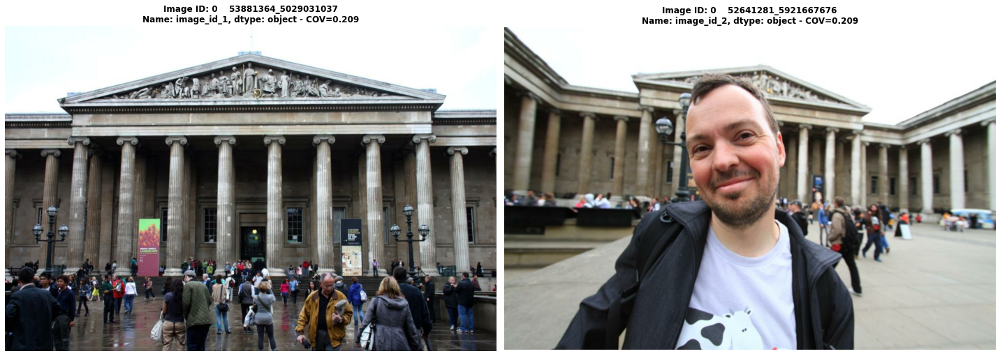




RANDOM PLOT FOR brandenburg_gate LOCATION SCENE


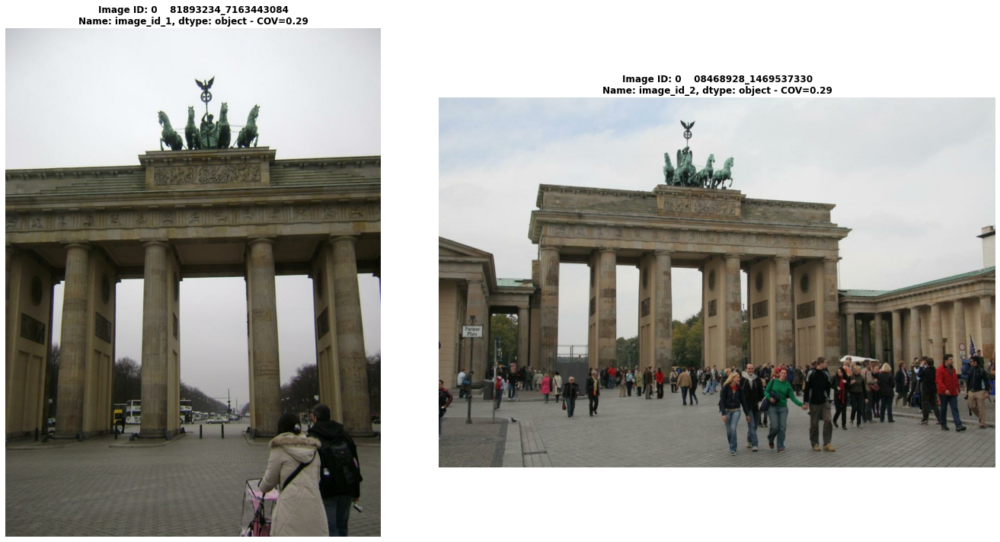




RANDOM PLOT FOR buckingham_palace LOCATION SCENE


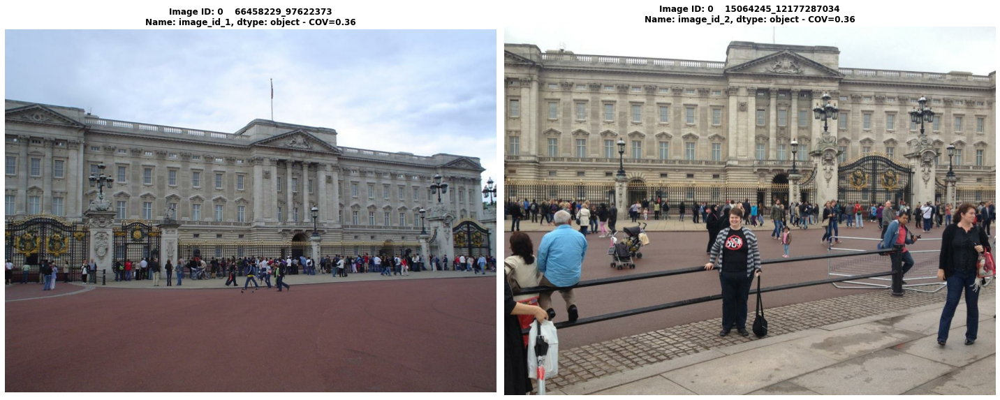




RANDOM PLOT FOR colosseum_exterior LOCATION SCENE


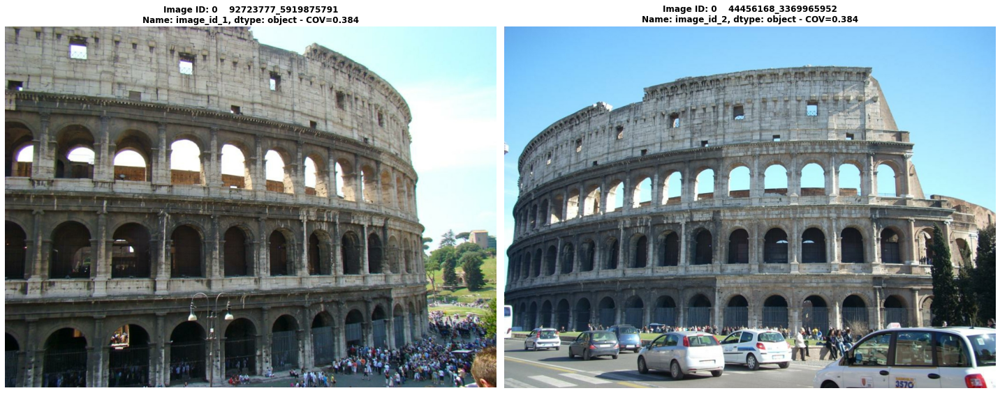




RANDOM PLOT FOR grand_place_brussels LOCATION SCENE


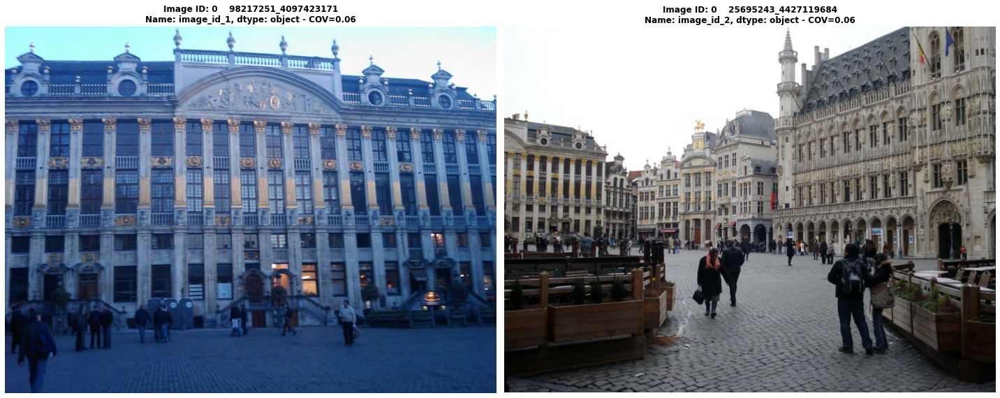




RANDOM PLOT FOR lincoln_memorial_statue LOCATION SCENE


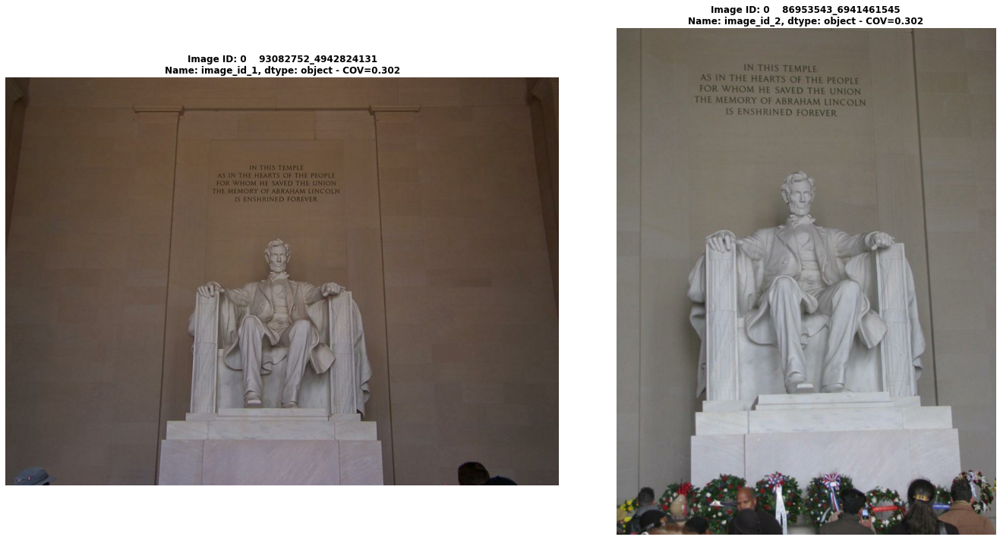




RANDOM PLOT FOR notre_dame_front_facade LOCATION SCENE


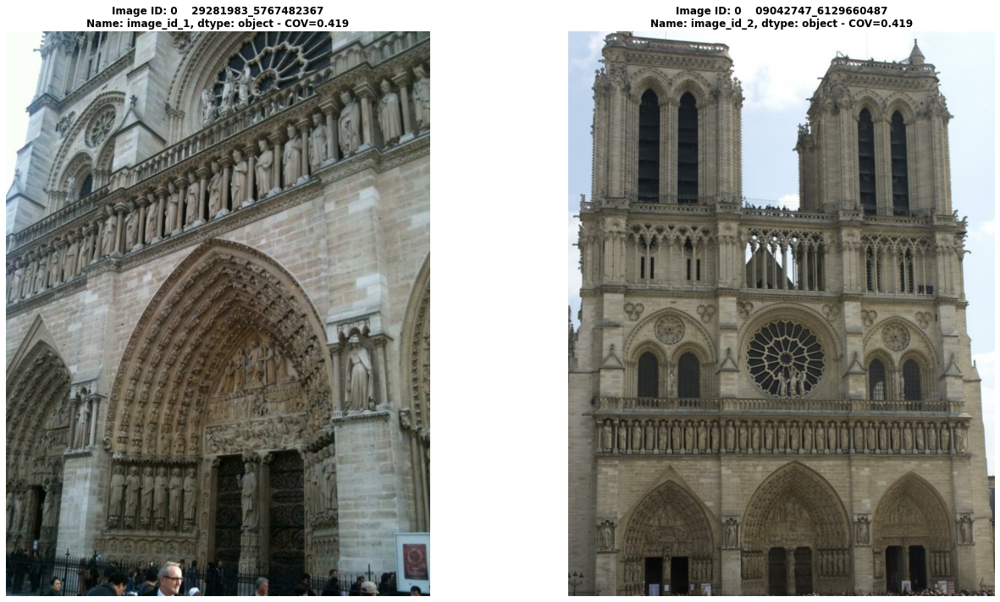




RANDOM PLOT FOR pantheon_exterior LOCATION SCENE


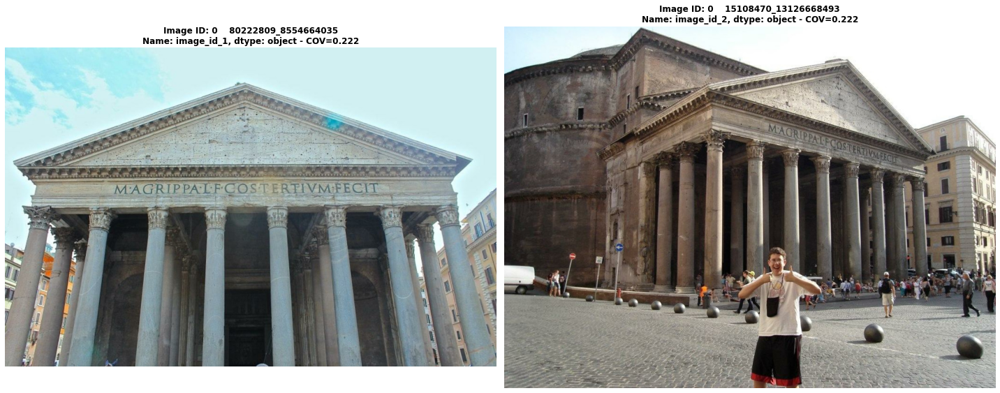




RANDOM PLOT FOR piazza_san_marco LOCATION SCENE


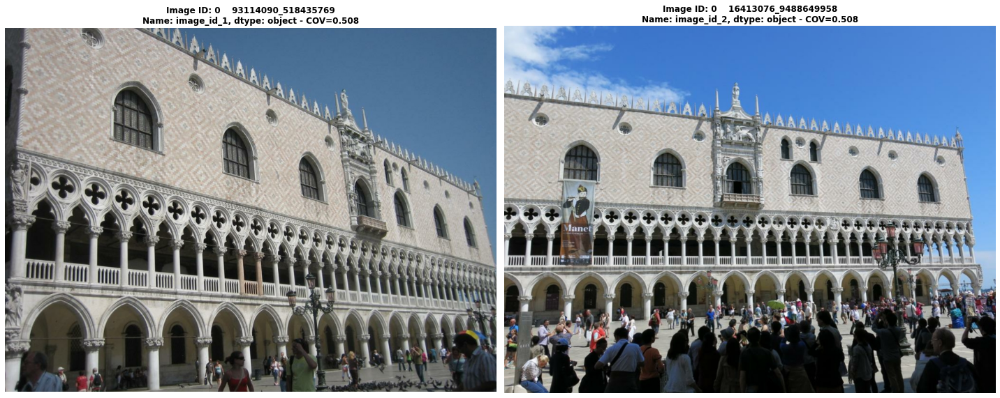




RANDOM PLOT FOR sacre_coeur LOCATION SCENE


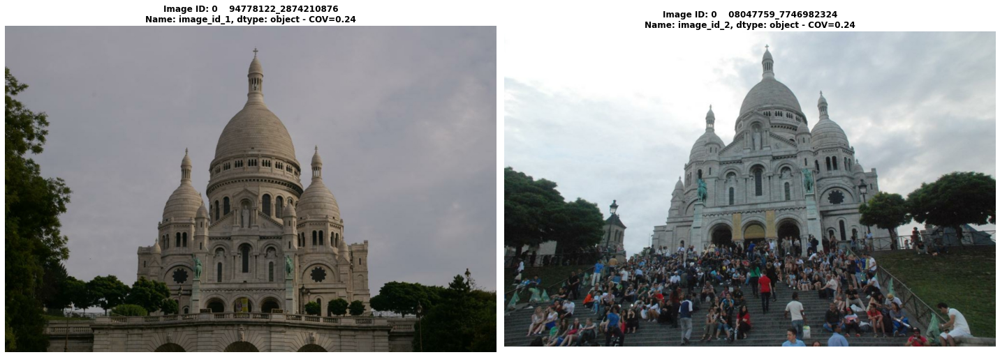




RANDOM PLOT FOR sagrada_familia LOCATION SCENE


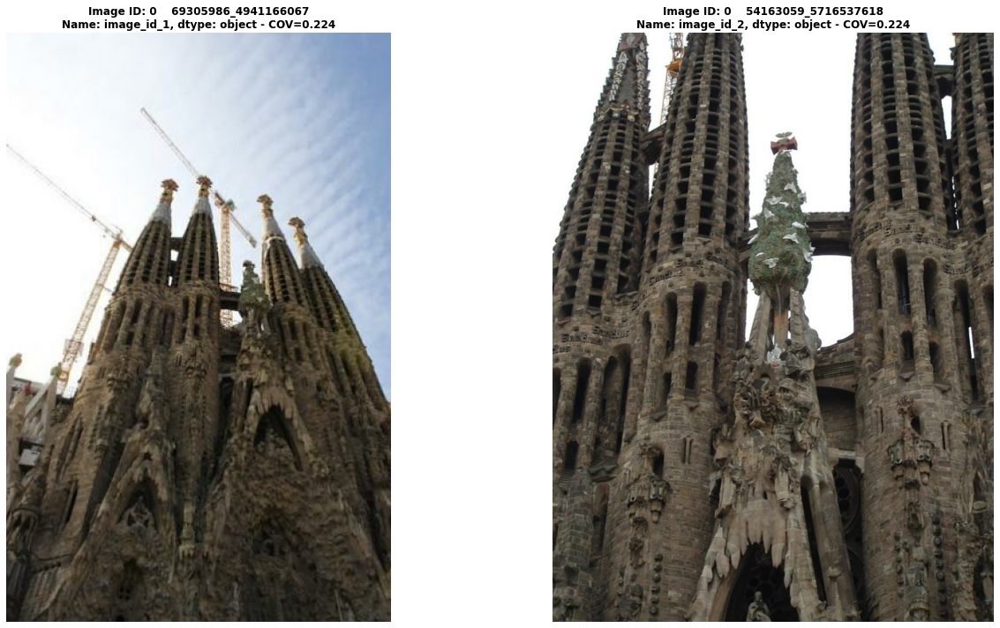




RANDOM PLOT FOR st_pauls_cathedral LOCATION SCENE


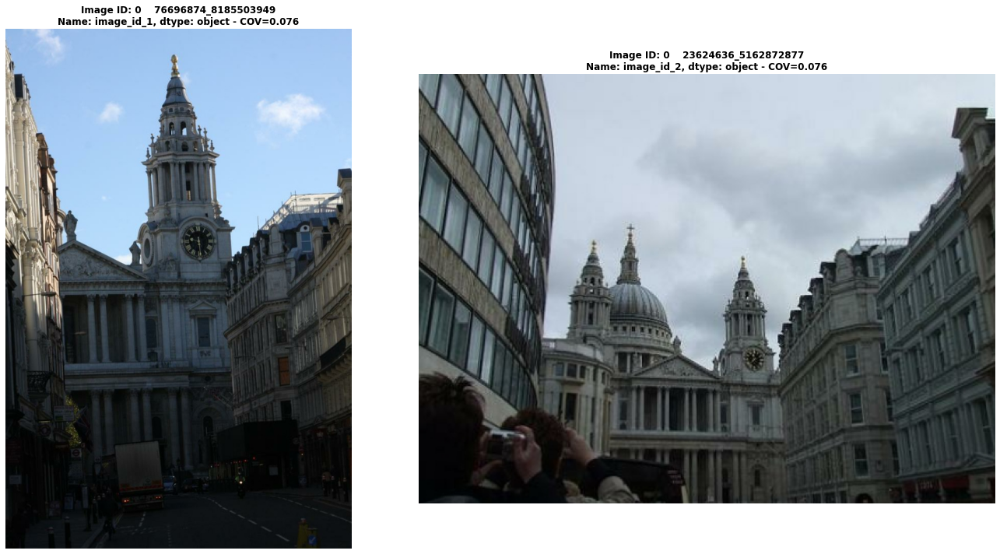




RANDOM PLOT FOR st_peters_square LOCATION SCENE


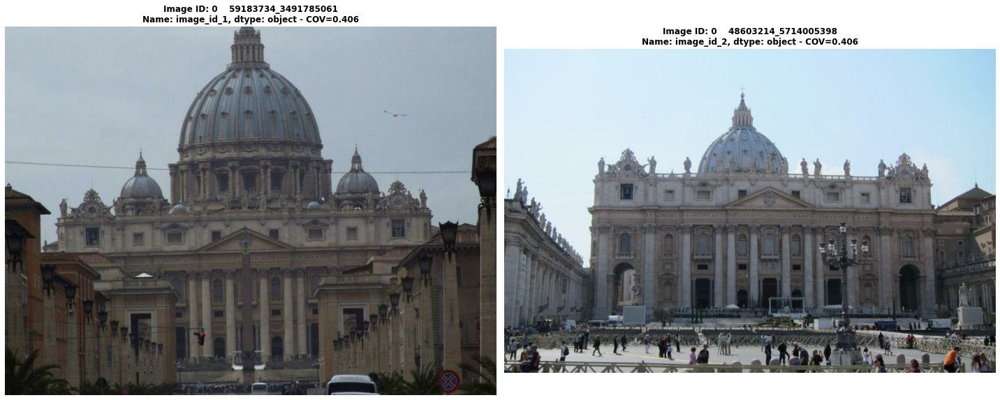




RANDOM PLOT FOR taj_mahal LOCATION SCENE


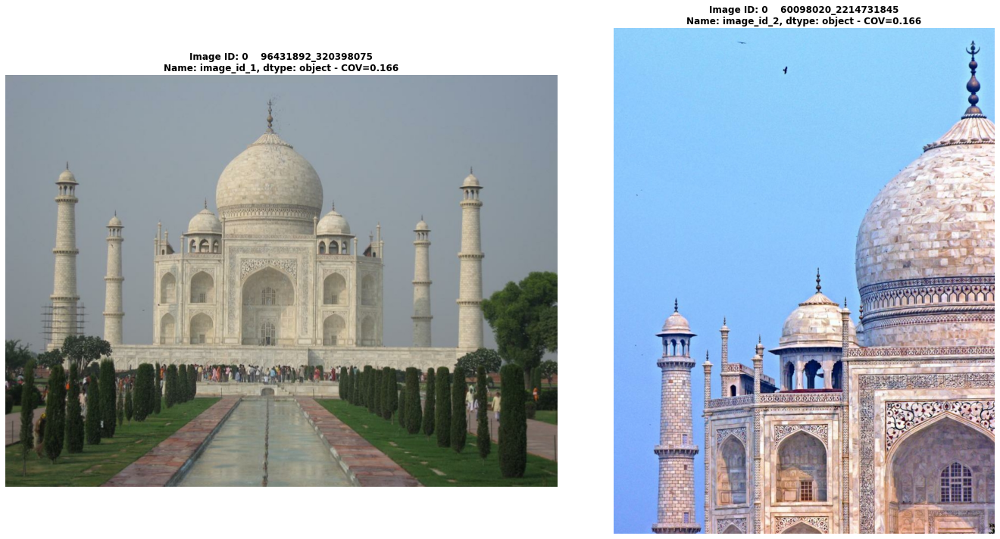




RANDOM PLOT FOR temple_nara_japan LOCATION SCENE


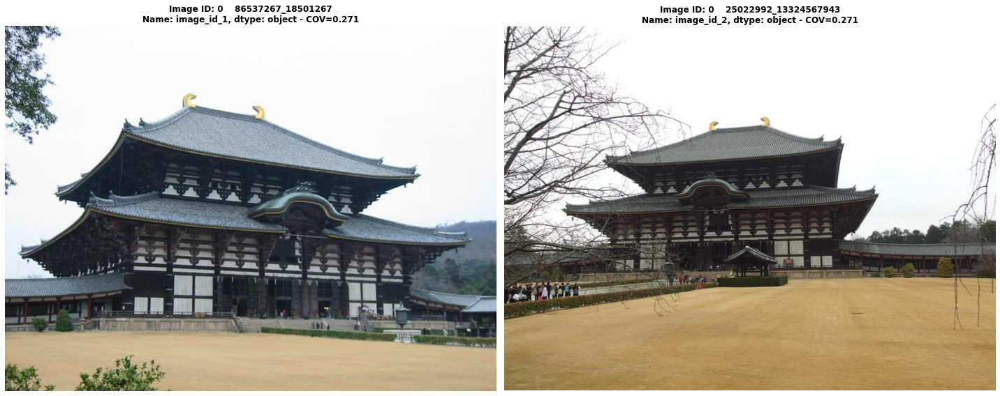




RANDOM PLOT FOR trevi_fountain LOCATION SCENE


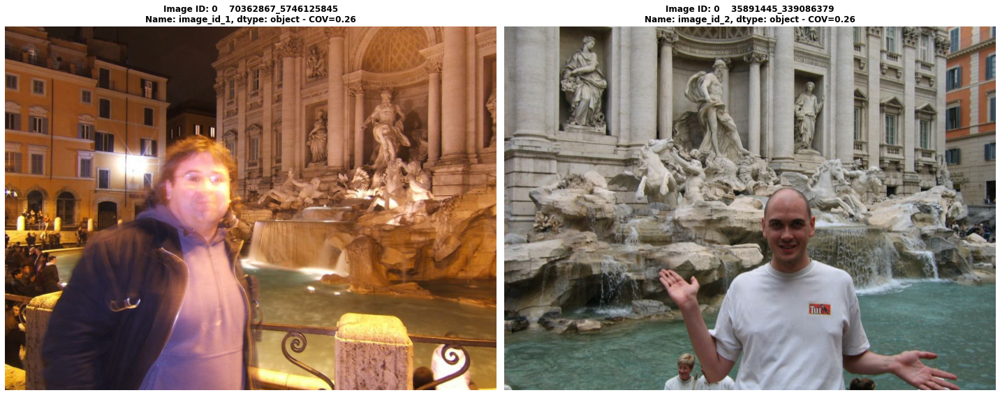

In [28]:
for _s in TRAIN_SCENES:
    print(f"\n\n\nRANDOM PLOT FOR {_s} LOCATION SCENE")
    pco_random_plot(train_map[_s]["pco_df"])